# <div class="header1" style="font-size: 38px; font-weight: bold; color: #FF5733">1. | 🚀 Introduction</div>
<br>

## <div class="header2" style="font-size: 25px; font-weight: bold;">1.1 | ❓ Business Problem</div>
Home Credit is currently using various statistical and Machine Learning methods to <b>predict credit scores</b>. The challenge is to unlock the full potential of their data to ensure that customers <b>capable of repayment</b> are not rejected during <b>loan applications</b>. Additionally, they aim to provide loans with appropriate principal amounts, maturities, and repayment calendars that motivate customers towards success
<br>

## <div class="header2" style="font-size: 25px; font-weight: bold;">1.2 | 🎯 Objectives</div>
This notebook <b>aims</b> to:
<ul>
    <li>Perform dataset exploration using various types of data visualization.</li>
    <li>Build machine learning models that can predict customer repayment capability.</li>
    <li>Identify the optimal model through analysis of their predictive outcomes</li>
    <li>Offer actionable business recommendations derived from the insights obtained.</li>
</ul>

## <div class="header2" style="font-size: 25px; font-weight: bold;">1.3 | 🤖 ML Models</div>
**The machine learning models used in this project are:** 
1. Logistic regression
2. Random forest
3. Neural Network
<br>

## <div class="header2" style="font-size: 25px; font-weight: bold;">1.4 | 📜 Dataset Overview</div>
There are **7 Datasets** available, they will be combined to a single final dataset before modeling<br><br>
<b>Dataset description:</b>

<img src="Struktur data.png" align="left" width="800">

# <div class="header1" style="font-size: 38px; font-weight: bold;color: #FF5733">2. | 📚 Import Libraries & Dataset</div>
<br>

👉 <b>Installing and importing <b>libraries</b>, preparing <b>notebook settings</b></b>

In [1]:
# --- Installing Libraries ---
%pip install ydata-profiling
%pip install scikit-learn
%pip install "pydantic==1.*"
%pip install ipywidgets

# --- Importing Libraries ---
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import ipywidgets

from sklearn.preprocessing import LabelEncoder
from ydata_profiling import ProfileReport
from sklearn.feature_selection import SelectKBest #feature selection
from sklearn.feature_selection import chi2
from sklearn.utils import resample #re-sampling
from sklearn.model_selection import train_test_split #data splitting
from sklearn.preprocessing import StandardScaler #normalize features
from sklearn.linear_model import LogisticRegression #logistic regression
from sklearn.naive_bayes import GaussianNB #gaussian naive bayes
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier #decision tree
from sklearn.ensemble import RandomForestClassifier #random forest
from sklearn.neighbors import KNeighborsClassifier #k-nearest neighbor
from sklearn.neural_network import MLPClassifier #neural network
from sklearn.metrics import confusion_matrix, classification_report 
from sklearn.metrics import roc_auc_score #roc score

# --- Notebook Settings ---
warnings.filterwarnings('ignore')

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


👉 <b>Importing dataset that will be used</b>

In [2]:
# --- Importing Dataset ---
app_train = pd.read_csv('../RAKAMIN/PROYEK AKHIR/application_train.csv')
app_test = pd.read_csv('../RAKAMIN/PROYEK AKHIR/application_test.csv')
bureau = pd.read_csv('../RAKAMIN/PROYEK AKHIR/bureau.csv')
bureau_bal = pd.read_csv('../RAKAMIN/PROYEK AKHIR/bureau_balance.csv')
ins_pay = pd.read_csv('../RAKAMIN/PROYEK AKHIR/installments_payments.csv')
cc_bal = pd.read_csv('../RAKAMIN/PROYEK AKHIR/credit_card_balance.csv')
pos_cash_bal = pd.read_csv('../RAKAMIN/PROYEK AKHIR/POS_CASH_balance.csv')
prev_app = pd.read_csv('../RAKAMIN/PROYEK AKHIR/previous_application.csv')

👉 <b>Preview all dataset</b>

In [3]:
app_train.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [4]:
app_test.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
bureau.head()

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


In [6]:
bureau_bal.head()

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


In [7]:
ins_pay.head()

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585


In [8]:
cc_bal.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,...,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,...,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,...,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,...,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,...,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,...,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0


In [9]:
pos_cash_bal.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0


In [10]:
prev_app.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


# <div class="header1" style="font-size: 38px; font-weight: bold;color: #FF5733">3. | 🆕 Dataset Combining</div>
<br>

## <div class="header2" style="font-size: 25px; font-weight: bold;">3.1 | 🤖 Pre-processing before Combining Datasets</div>


👉 <b>Find and remove different categorical values from application train and test dataset</b>

In [11]:
for col in app_train.columns[app_train.dtypes == 'object']:
    diff = set(app_train[col].unique()) - set(app_test[col].unique())
    if diff:
        print(f'Feature: {col}; Different values: {diff}')


Feature: CODE_GENDER; Different values: {'XNA'}
Feature: NAME_INCOME_TYPE; Different values: {'Maternity leave'}
Feature: NAME_FAMILY_STATUS; Different values: {'Unknown'}


In [12]:
values_to_replace = ['XNA', 'Maternity leave', 'Unknown']

for col in ['CODE_GENDER', 'NAME_INCOME_TYPE', 'NAME_FAMILY_STATUS']:
    app_train[col] = app_train[col].replace(values_to_replace, np.nan)

👉 <b>Labeling app_train and app_test categorical values</b>

In [13]:
label = LabelEncoder()

In [14]:
for col in app_train.columns[app_train.dtypes == 'object']:
    d = app_train[col].value_counts()
    if app_train[col].nunique() == 2:
        d[0] = 0
        d[1] = 1      
    app_train[col] = app_train[col].map(d)
    app_test[col] = app_test[col].map(d)

👉 <b>Labeling bureau categorical values</b>

In [15]:
for col in bureau.columns[bureau.dtypes=='object']:
    bureau[col] = label.fit_transform(bureau[col])

👉 <b>One hot encoding bureau_balance categorical values</b>


In [16]:
for val in bureau_bal['STATUS'].unique():
    bureau_bal['STATUS_' + val] = (bureau_bal['STATUS'] == val).map(int)

bureau_bal.drop(columns=['STATUS'], inplace = True)


👉 <b>Labeling cc_bal categorical values</b>

In [17]:
cc_bal['NAME_CONTRACT_STATUS'] = label.fit_transform(cc_bal['NAME_CONTRACT_STATUS'])

👉 <b>Labeling pos_cash_bal categorical values</b>

In [18]:
pos_cash_bal['NAME_CONTRACT_STATUS'] = label.fit_transform(pos_cash_bal['NAME_CONTRACT_STATUS'])

👉 <b>Labeling prev_app categorical values</b>

In [19]:
for col in prev_app.columns[prev_app.dtypes == 'object']:
    if prev_app[col].nunique() == 2:
        d = prev_app[col].value_counts()
        prev_app[col] = prev_app[col].map({d[0]: 0, d[1]: 1})
    else:        
        for val in prev_app[col].unique():
            prev_app[str(col) + '_' + str(val)] = (prev_app[col] == val).map(int)
        prev_app.drop(columns=col, inplace = True)

## <div class="header2" style="font-size: 25px; font-weight: bold;">3.2 | 🤖 Combining Datasets Into One</div>


👉 <b>Combining bureau and bureau_balance</b>

In [20]:
for col in bureau_bal.drop(columns=['SK_ID_BUREAU']).columns:
    res = bureau_bal.groupby(by = 'SK_ID_BUREAU')[col].mean()
    bureau['Balance_' + str(col)] = bureau['SK_ID_BUREAU'].map(lambda x: res[x] if x in res.index else np.nan)

👉 <b>Combining ins_pay and prev_app</b>

In [21]:
for col in ins_pay.drop(columns=['SK_ID_PREV', 'SK_ID_CURR']).columns:
    res = ins_pay.groupby(by = 'SK_ID_PREV')[col].mean()
    prev_app['IP_' + col] = prev_app['SK_ID_PREV'].map(lambda x: res[x] if x in res.index else np.nan)

👉 <b>Combining cc_bal and prev_app</b>

In [22]:
for col in cc_bal.drop(columns=['SK_ID_PREV', 'SK_ID_CURR']).columns:
    res = cc_bal.groupby(by = 'SK_ID_PREV')[col].mean()
    prev_app['CCB_' + col] = prev_app['SK_ID_PREV'].map(lambda x: res[x] if x in res.index else np.nan)

👉 <b>Combining pos_cash_bal with prev_app</b>

In [23]:
for col in pos_cash_bal.drop(columns=['SK_ID_PREV', 'SK_ID_CURR']).columns:
    res = pos_cash_bal.groupby(by = 'SK_ID_PREV')[col].mean()
    prev_app['POS_' + col] = prev_app['SK_ID_PREV'].map(lambda x: res[x] if x in res.index else np.nan)
    
prev_app_merged = prev_app.copy()
bureau_merged = bureau.copy()

👉 <b>Combining bureau with app_train and app_test</b>

In [24]:
for col in bureau_merged.drop(columns = ['SK_ID_CURR', 'SK_ID_BUREAU']).columns:
    res = bureau_merged.groupby(by = 'SK_ID_CURR')[col].mean()
    app_train['Bureau_' + str(col)] = bureau_merged['SK_ID_CURR'].map(lambda x: res[x] if x in res.index else np.nan)
    app_test['Bureau_' + str(col)] = bureau_merged['SK_ID_CURR'].map(lambda x: res[x] if x in res.index else np.nan)

👉 <b>Combining prev_app with app_train and app_test</b>

In [25]:
for col in prev_app_merged.drop(columns=['SK_ID_CURR', 'SK_ID_PREV']).columns:
    res = prev_app_merged.groupby(by = 'SK_ID_CURR')[col].mean()
#     app_train['Prev_' + str(col)] = prev_app_merged['SK_ID_CURR'].map(lambda x: res[x] if x in res.index else np.nan)
    app_test['Prev_' + str(col)] = prev_app_merged['SK_ID_CURR'].map(lambda x: res[x] if x in res.index else np.nan)
    
for col in prev_app_merged.drop(columns=['SK_ID_CURR', 'SK_ID_PREV']).columns:
    res = prev_app_merged.groupby(by = 'SK_ID_CURR')[col].mean()
    app_train['Prev_' + str(col)] = prev_app_merged['SK_ID_CURR'].map(lambda x: res[x] if x in res.index else np.nan)
   # app_test['Prev_' + str(col)] = prev_app_merged['SK_ID_CURR'].map(lambda x: res[x] if x in res.index else np.nan)

In [26]:
app_train.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,Prev_CCB_CNT_INSTALMENT_MATURE_CUM,Prev_CCB_NAME_CONTRACT_STATUS,Prev_CCB_SK_DPD,Prev_CCB_SK_DPD_DEF,Prev_POS_MONTHS_BALANCE,Prev_POS_CNT_INSTALMENT,Prev_POS_CNT_INSTALMENT_FUTURE,Prev_POS_NAME_CONTRACT_STATUS,Prev_POS_SK_DPD,Prev_POS_SK_DPD_DEF
0,100002,1,0,1.0,0,0,0,202500.0,406597.5,24700.5,...,NaN,NaN,NaN,NaN,-8.250000,8.083333,6.500000,1.785714,0.000000,0.000000
1,100003,0,0,0.0,0,1,0,270000.0,1293502.5,35698.5,...,6.666667,0.064516,0.0,0.0,-19.000000,17.630769,14.497436,0.656410,0.000000,0.000000
2,100004,0,1,1.0,1,0,0,67500.0,135000.0,6750.0,...,12.782051,0.000000,0.0,0.0,-43.500000,8.500000,4.916667,0.333333,0.000000,0.000000
3,100006,0,0,0.0,0,0,0,135000.0,312682.5,29686.5,...,NaN,NaN,NaN,NaN,-33.416667,12.400253,6.796086,0.456805,0.000000,0.000000
4,100007,0,0,1.0,0,0,0,121500.0,513000.0,21865.5,...,3.600000,0.000000,0.0,0.0,-26.428571,11.333333,8.111111,0.461190,0.126984,0.126984


In [34]:
app_train.to_csv('../RAKAMIN/FINAL DATASET/final_train.csv')

In [36]:
app_test.to_csv('../RAKAMIN/FINAL DATASET/final_test.csv')

👉 <b>Optimizing combined dataset memory usage</b>

In [2]:
# --- Function to reduce dataset memory usage ---
def reduce_mem_usage(df):
    start_mem = df.memory_usage().sum() / 1024**2
    print('Before Optimization: {:.2f} MB'.format(start_mem))
    
    int_types = ["int8", "int16", "int32", "int64"]
    float_types = ["float16", "float32", "float64"]
    
    for col in df.columns:
        col_type = df[col].dtype
        
        if col_type in int_types:
            for int_type in int_types:
                if np.iinfo(int_type).min <= df[col].min() <= df[col].max() <= np.iinfo(int_type).max:
                    df[col] = df[col].astype(int_type)
                    break
        elif col_type in float_types:
            for float_type in float_types:
                if np.finfo(float_type).min <= df[col].min() <= df[col].max() <= np.finfo(float_type).max:
                    df[col] = df[col].astype(float_type)
                    break
        elif col_type == "object":
            df[col] = df[col].astype('category')

    end_mem = df.memory_usage().sum() / 1024**2
    
    print('After optimization: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))
    
    return df

# --- Function to import and call the reduce memory function ---
def import_data(file):
    df = pd.read_csv(file, parse_dates=True, keep_date_col=True)
    df = reduce_mem_usage(df)
    return df

In [111]:
df_train = import_data('../RAKAMIN/FINAL DATASET/final_train.csv')

Before Optimization: 804.72 MB
After optimization: 218.78 MB
Decreased by 72.8%


In [4]:
df_test = import_data('../RAKAMIN/FINAL DATASET/final_test.csv')

Before Optimization: 127.19 MB
After optimization: 34.49 MB
Decreased by 72.9%


# <div class="header1" style="font-size: 38px; font-weight: bold;color: #FF5733">4. | 📊 Exploratory Data Analysis</div>
<br>

## <div class="header2" style="font-size: 25px; font-weight: bold;">4.1 | 🤖 Dataset Profiling Report</div>


In [112]:
# --- Initial Dataset Report ---
ProfileReport(df_train, title='Application Dataset Report', minimal=True, progress_bar=False, samples=None, correlations=None, interactions=None, explorative=True, dark_mode=True, notebook={'iframe':{'height': '600px'}}, html={'style':{'primary_color': '#FFCC00'}}, missing_diagrams={'heatmap': False, 'dendrogram': False}).to_notebook_iframe()

## <div class="header2" style="font-size: 25px; font-weight: bold;">4.2 | 🤖 Multivariate Analysis</div>


👉 <b>Family Status, Amount Credit of Loan, Target, and Rating of Region where Client Lives</b>

In [116]:
app_train = pd.read_csv('../RAKAMIN/PROYEK AKHIR/application_train.csv')

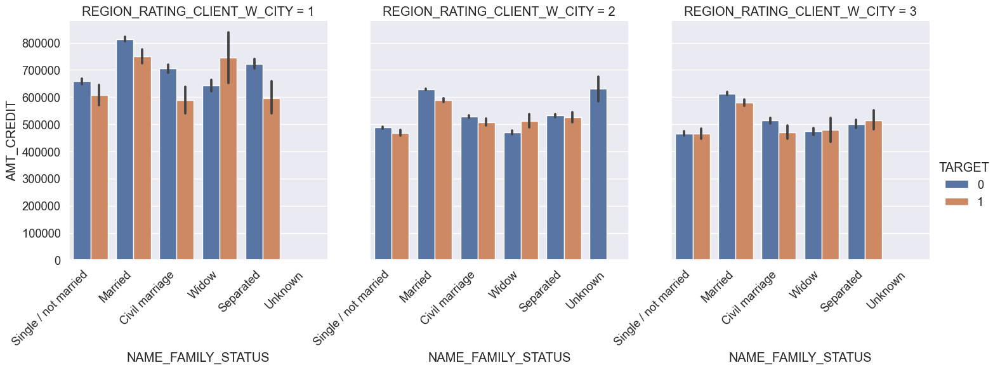

In [117]:
fig = sns.catplot(x = 'NAME_FAMILY_STATUS',
            y = 'AMT_CREDIT', 
            hue = 'TARGET', 
            col = 'REGION_RATING_CLIENT_W_CITY', 
            kind = 'bar',
            data = app_train)

fig.set_xticklabels(rotation=45, horizontalalignment='right')
plt.show()

👉 <b>Education Type, Amount Credit of Loan, Target, and Rating of Region where Client Lives</b>

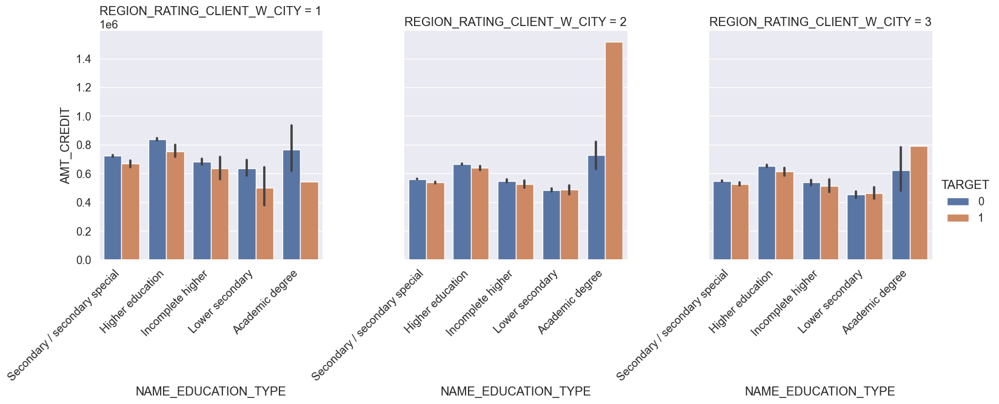

In [118]:
fig = sns.catplot(x = 'NAME_EDUCATION_TYPE',
            y = 'AMT_CREDIT', 
            hue = 'TARGET', 
            col = 'REGION_RATING_CLIENT_W_CITY', 
            kind = 'bar',
            data = app_train)

fig.set_xticklabels(rotation=45, horizontalalignment='right')
plt.show()

# <div class="header1" style="font-size: 38px; font-weight: bold;color: #FF5733">5. | ⚙️ Pre-processing</div>
<br>

## <div class="header2" style="font-size: 25px; font-weight: bold;">5.1 | 🤖 Handling Missing Data</div>


👉 <b>Combining train & test data, separate 'Target' column for pre-processing</b>

In [5]:
df = df_train.append(df_test)

In [6]:
df2 = df.drop(columns=['TARGET'])

👉 <b>Show & drop features with >70% missing data</b>

In [7]:
# --- Extract the features with >70% missing data ---
df_missing = pd.DataFrame(df2.isnull().sum() / len(df2)).sort_values(by=0, ascending=False)
df_missing_70 = df_missing[df_missing[0] > 0.7]
df_missing_70

,0
Prev_FLAG_LAST_APPL_PER_CONTRACT,1.000000
Prev_RATE_INTEREST_PRIVILEGED,0.981937
Prev_RATE_INTEREST_PRIMARY,0.981937
Prev_CCB_AMT_PAYMENT_CURRENT,0.740916
Prev_CCB_AMT_DRAWINGS_OTHER_CURRENT,0.740781
Prev_CCB_AMT_DRAWINGS_ATM_CURRENT,0.740781
Prev_CCB_CNT_DRAWINGS_ATM_CURRENT,0.740781
Prev_CCB_CNT_DRAWINGS_OTHER_CURRENT,0.740781
Prev_CCB_CNT_DRAWINGS_POS_CURRENT,0.740781
Prev_CCB_AMT_DRAWINGS_POS_CURRENT,0.740781


In [8]:
# --- Drop the features ---
df2.drop(columns=df_missing_70.index, inplace=True)

👉 <b>Fill Features with <70% Missing Data using the Median</b>

In [9]:
for feature in  df_missing[(df_missing[0] > 0) & (df_missing[0] <= 0.7)].index:
    df2[feature] = df2[feature].fillna(df2[feature].median())

In [10]:
sum(df2.isna().sum())/(df2.shape[0]*df2.shape[1])*100


0.0

## <div class="header2" style="font-size: 25px; font-weight: bold;">5.2 | 🤖 Handling Small Variance & Unused Features</div>


👉 <b>Show & drop features with <0.01 variance</b>

In [11]:
small_var = df2.columns[(df2.std(axis = 0) < .01).values]
small_var

Index(['CODE_GENDER', 'REGION_POPULATION_RELATIVE', 'DAYS_REGISTRATION',
       'OWN_CAR_AGE', 'FLAG_MOBIL', 'OCCUPATION_TYPE', 'CNT_FAM_MEMBERS',
       'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3',
       ...
       'Prev_CCB_CNT_INSTALMENT_MATURE_CUM', 'Prev_CCB_NAME_CONTRACT_STATUS',
       'Prev_CCB_SK_DPD', 'Prev_CCB_SK_DPD_DEF', 'Prev_POS_MONTHS_BALANCE',
       'Prev_POS_CNT_INSTALMENT', 'Prev_POS_CNT_INSTALMENT_FUTURE',
       'Prev_POS_NAME_CONTRACT_STATUS', 'Prev_POS_SK_DPD',
       'Prev_POS_SK_DPD_DEF'],
      dtype='object', length=253)

In [12]:
df2.drop(columns = small_var, inplace=True)

In [13]:
df2['TARGET'] = df['TARGET']

👉 <b>Drop Unused Features & Split Data (for training and predicting)</b>

In [16]:
df2.drop(columns=['Unnamed: 0'], inplace=True)

In [17]:
#split ke data training dan testing
df_train = df2[:307511]
df_test = df2[307511:]

In [ ]:
df_train.drop(['SK_ID_CURR'], inplace=True, axis=1)


## <div class="header2" style="font-size: 25px; font-weight: bold;">5.3 | 🤖 Feature Selection, Remove Negative Values & Upsampling Target</div>


👉 <b>Remove Negative Values</b>

In [19]:
# --- Remove negative values ---
df_train.iloc[:,:79] = df_train.iloc[:,:79].abs()

In [20]:
# --- Extract target to Y ---
x = df_train.drop(['TARGET'], axis=1)
y = df_train['TARGET']

👉 <b>Feature Selection</b>

In [21]:
# --- Feature selection ---
bestfeatures = SelectKBest(score_func=chi2, k=10)
fit = bestfeatures.fit(x,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(x.columns)
featureScores = pd.concat([dfcolumns, dfscores], axis = 1)
featureScores.columns = ['Features', 'Score']
print('The features that correlate well with target feature:\n')
featureScores.sort_values(by=['Score'], ascending=False)

The features that correlate well with target feature:



,Features,Score
14,DAYS_EMPLOYED,1.954124e+08
7,AMT_GOODS_PRICE,1.223080e+08
5,AMT_CREDIT,7.669987e+07
9,NAME_INCOME_TYPE,2.665760e+07
10,NAME_EDUCATION_TYPE,1.732433e+07
...,...,...
38,FLAG_DOCUMENT_7,7.098728e-01
48,FLAG_DOCUMENT_19,5.663612e-01
36,FLAG_DOCUMENT_5,3.020010e-02
49,FLAG_DOCUMENT_20,1.425955e-02


👉 <b>Upsample Target Feature</b>

In [22]:
# --- Create two different dataframe of majority and minority class ---
df_majority = df_train[(df_train['TARGET']==0)] 
df_minority = df_train[(df_train['TARGET']==1)] 

# --- Upsample minority class ---
df_minority_upsampled = resample(df_minority, 
                                 replace=True,    # sample with replacement
                                 n_samples= 282686, # to match majority class
                                 random_state=42)  # reproducible results

# --- Combine majority class with upsampled minority class --
df_upsampled = pd.concat([df_minority_upsampled, df_majority])

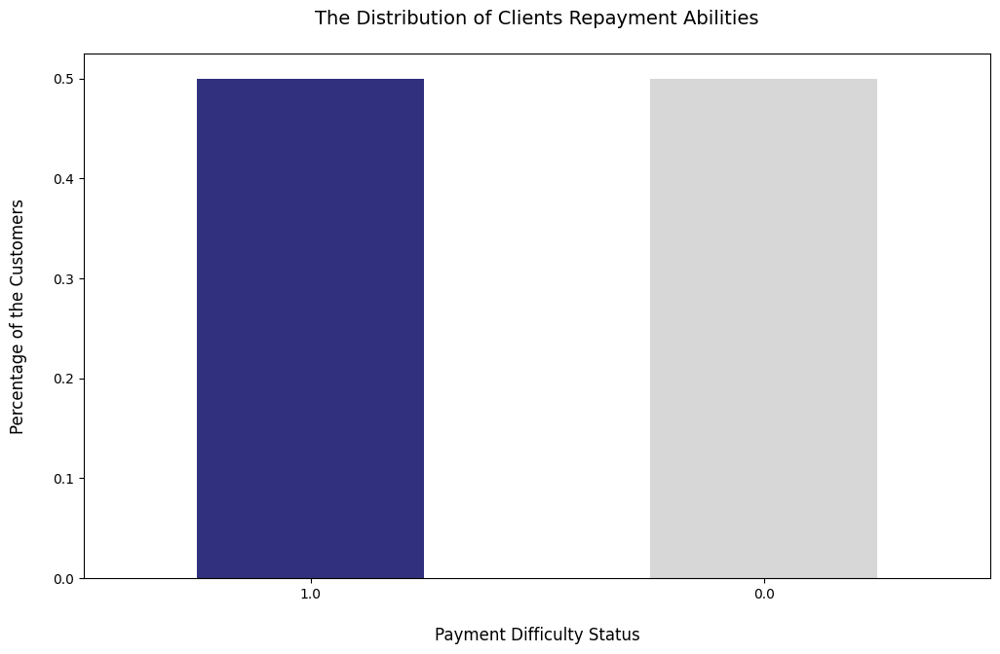

In [23]:
# --- Visualize Target Feature ---
fig = plt.figure(figsize = (12,7))
df_upsampled['TARGET'].value_counts(normalize=True).plot(kind='bar', color= ['midnightblue','lightgrey'], alpha = 0.9, rot=0)
plt.title('The Distribution of Clients Repayment Abilities\n', fontsize=14)
plt.ylabel('Percentage of the Customers\n', fontsize=12)
plt.xlabel('\nPayment Difficulty Status', fontsize=12)
plt.show()

## <div class="header2" style="font-size: 25px; font-weight: bold;">5.4 | 🤖 Split Data for Training & Normalize Features</div>

👉 <b>Extract Only the Top 20 Features That Correlates With Target</b>

In [25]:
# --- Define x and y features (top 20 features based on previous analysis)
x_balanced = df_upsampled[['DAYS_EMPLOYED', 'AMT_GOODS_PRICE', 'AMT_CREDIT', 
                           'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 
                           'NAME_HOUSING_TYPE', 'DAYS_BIRTH', 'AMT_INCOME_TOTAL', 
                           'Bureau_AMT_CREDIT_SUM_DEBT', 'DAYS_ID_PUBLISH', 'NAME_TYPE_SUITE',
                          'Bureau_AMT_CREDIT_SUM_OVERDUE', 'AMT_ANNUITY', 'FONDKAPREMONT_MODE', 'Bureau_AMT_CREDIT_MAX_OVERDUE',
                          'Bureau_AMT_CREDIT_SUM', 'Prev_CCB_AMT_DRAWINGS_CURRENT', 'Bureau_AMT_ANNUITY', 'Prev_CCB_AMT_PAYMENT_TOTAL_CURRENT']]
y_balanced = df_upsampled['TARGET']

👉 <b>Split Data for Training</b>

In [102]:
# --- Split the Data for Training ---
X_train, X_test, y_train, y_test = train_test_split(x_balanced, y_balanced, test_size=0.2, random_state=42)
print(X_train.shape, X_test.shape)

(452297, 20) (113075, 20)


👉 <b>Normalize Features using Standard Scaler</b>

In [103]:
# --- Normalize Features using Standard Scaler ---
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.fit_transform(X_test)

# <div class="header1" style="font-size: 38px; font-weight: bold;color: #FF5733">6. | 🛠️ Build & Evaluate Model</div>
<br>

## <div class="header2" style="font-size: 25px; font-weight: bold;">6.1 | 🤖 Logistic Regression </div>

👉 <b>Train the Model</b>

In [104]:
# ---Train the model ---
log_model = LogisticRegression().fit(X_train, y_train)
print(log_model)

LogisticRegression()


👉 <b>Predict Train Data & Show Result</b>

In [30]:
# --- Predict train data ---
y_train_pred_log = log_model.predict(X_train)

# --- Print classification report ---
print('Classification Report Training Model (Logistic Regression):')
print(classification_report(y_train, y_train_pred_log))

Classification Report Training Model (Logistic Regression):


              precision    recall  f1-score   support

         0.0       0.60      0.58      0.59    226185
         1.0       0.60      0.61      0.61    226112

    accuracy                           0.60    452297
   macro avg       0.60      0.60      0.60    452297
weighted avg       0.60      0.60      0.60    452297



👉 <b>Display Confusion Matrix</b>

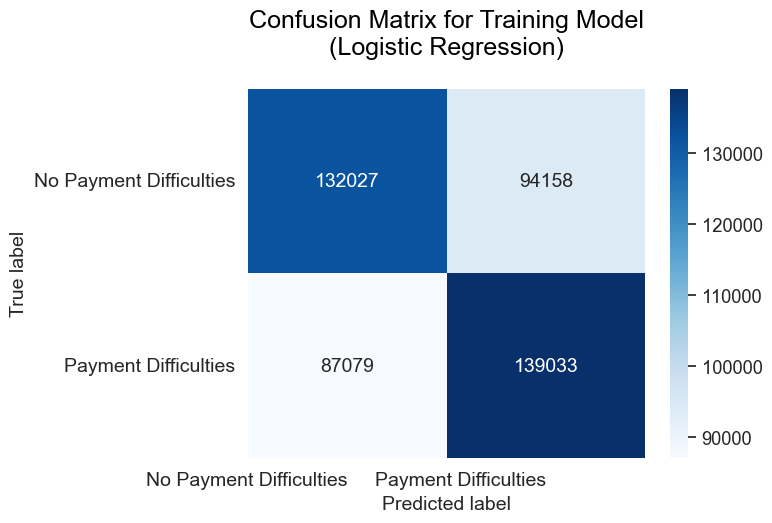

In [106]:
# --- Create confusion matrix as a dataFrame ---
confusion_matrix_log = pd.DataFrame((confusion_matrix(y_train, y_train_pred_log)), ('No Payment Difficulties', 'Payment Difficulties'), ('No Payment Difficulties', 'Payment Difficulties'))

# --- Plot confusion matrix
plt.figure()
heatmap = sns.heatmap(confusion_matrix_log, annot=True, annot_kws={'size': 14}, fmt='d', cmap='Blues')
heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=14)
heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=0, ha='right', fontsize=14)

plt.title('Confusion Matrix for Training Model\n(Logistic Regression)\n', fontsize=18, color='black')
plt.ylabel('True label', fontsize=14)
plt.xlabel('Predicted label', fontsize=14)
plt.show()

👉 <b>Predict Test Data & Show Result</b>

In [32]:
# --- Predict data test ---
y_test_pred_log = log_model.predict(X_test)

# print classification report
print('Classification Report Testing Model (Logistic Regression):')
print(classification_report(y_test, y_test_pred_log))

Classification Report Testing Model (Logistic Regression):
              precision    recall  f1-score   support

         0.0       0.60      0.58      0.59     56501
         1.0       0.60      0.62      0.61     56574

    accuracy                           0.60    113075
   macro avg       0.60      0.60      0.60    113075
weighted avg       0.60      0.60      0.60    113075



👉 <b>Display Confusion Matrix</b>

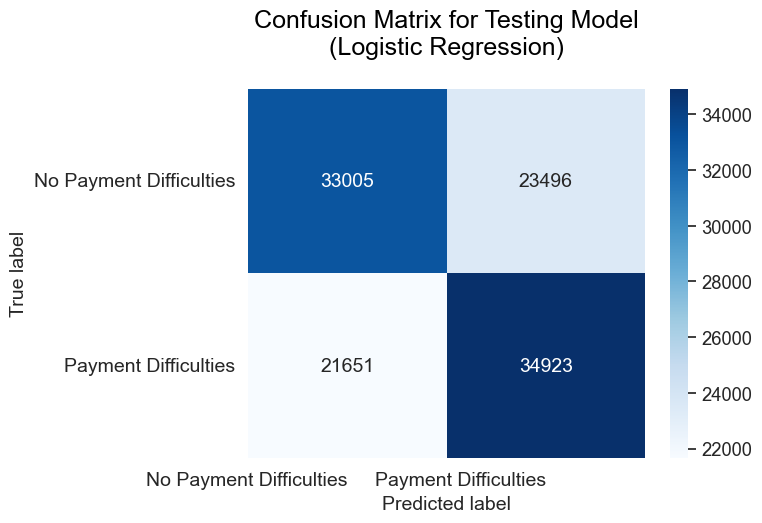

In [97]:
# form confusion matrix as a dataFrame
confusion_matrix_log = pd.DataFrame((confusion_matrix(y_test, y_test_pred_log)), ('No Payment Difficulties', 'Payment Difficulties'), ('No Payment Difficulties', 'Payment Difficulties'))

# plot confusion matrix
plt.figure()
heatmap = sns.heatmap(confusion_matrix_log, annot=True, annot_kws={'size': 14}, fmt='d', cmap='Blues')
heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=14)
heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=0, ha='right', fontsize=14)

plt.title('Confusion Matrix for Testing Model\n(Logistic Regression)\n', fontsize=18, color='black')
plt.ylabel('True label', fontsize=14)
plt.xlabel('Predicted label', fontsize=14)
plt.show()

👉 <b>Display Overall Accuracy & ROC Score</b>

In [34]:
acc_log_train=round(log_model.score(X_train,y_train)*100,2)
acc_log_test=round(log_model.score(X_test,y_test)*100,2)
print("Training Accuracy: % {}".format(acc_log_train))
print("Test Accuracy: % {}".format(acc_log_test))

Training Accuracy: % 59.93
Test Accuracy: % 60.07


In [35]:
# ROC scores
roc_auc_log = round(roc_auc_score(y_test, y_test_pred_log),4)
print('ROC AUC:', roc_auc_log)

ROC AUC: 0.6007


## <div class="header2" style="font-size: 25px; font-weight: bold;">6.2 | 🤖 Random Forest</div>


👉 <b>Train the Model</b>

In [36]:
# train the model
rf_model = RandomForestClassifier().fit(X_train, y_train)
print(rf_model)

RandomForestClassifier()


👉 <b>Predict Train Data & Show Result</b>

In [37]:
# predict data train
y_train_pred_dt = rf_model.predict(X_train)

# print classification report
print('Classification Report Training Model (Decision Tree Classifier):')
print(classification_report(y_train, y_train_pred_dt))

Classification Report Training Model (Decision Tree Classifier):
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    226185
         1.0       1.00      1.00      1.00    226112

    accuracy                           1.00    452297
   macro avg       1.00      1.00      1.00    452297
weighted avg       1.00      1.00      1.00    452297



👉 <b>Display Confusion Matrix</b>

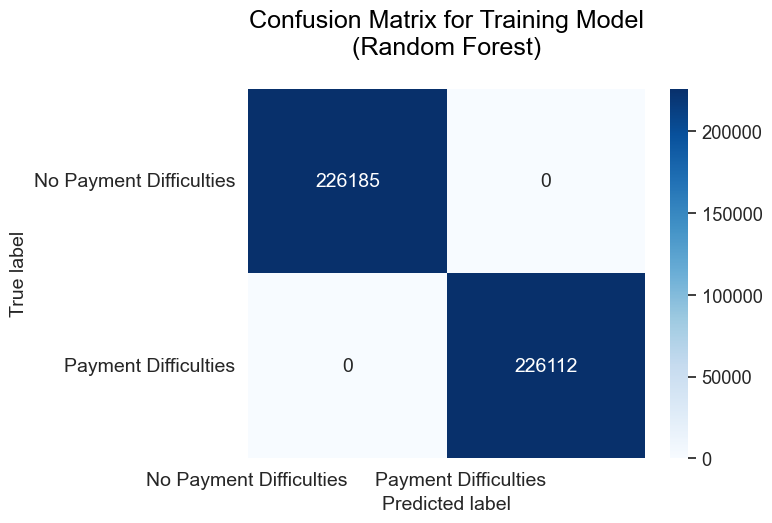

In [107]:
# form confusion matrix as a dataFrame
confusion_matrix_rf = pd.DataFrame((confusion_matrix(y_train, y_train_pred_dt)), ('No Payment Difficulties', 'Payment Difficulties'), ('No Payment Difficulties', 'Payment Difficulties'))

# plot confusion matrix
plt.figure()
heatmap = sns.heatmap(confusion_matrix_rf, annot=True, annot_kws={'size': 14}, fmt='d', cmap='Blues')
heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=14)
heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=0, ha='right', fontsize=14)

plt.title('Confusion Matrix for Training Model\n(Random Forest)\n', fontsize=18, color='black')
plt.ylabel('True label', fontsize=14)
plt.xlabel('Predicted label', fontsize=14)
plt.show()

👉 <b>Predict Test Data & Show Result</b>

In [39]:
# predict data test
y_test_pred_rf = rf_model.predict(X_test)
from sklearn.metrics import confusion_matrix, classification_report

# print classification report
print('Classification Report Testing Model (Random Forest Classifier):')
print(classification_report(y_test, y_test_pred_rf))

Classification Report Testing Model (Random Forest Classifier):
              precision    recall  f1-score   support

         0.0       0.93      1.00      0.96     56501
         1.0       1.00      0.93      0.96     56574

    accuracy                           0.96    113075
   macro avg       0.97      0.96      0.96    113075
weighted avg       0.97      0.96      0.96    113075



👉 <b>Display Confusion Matrix</b>

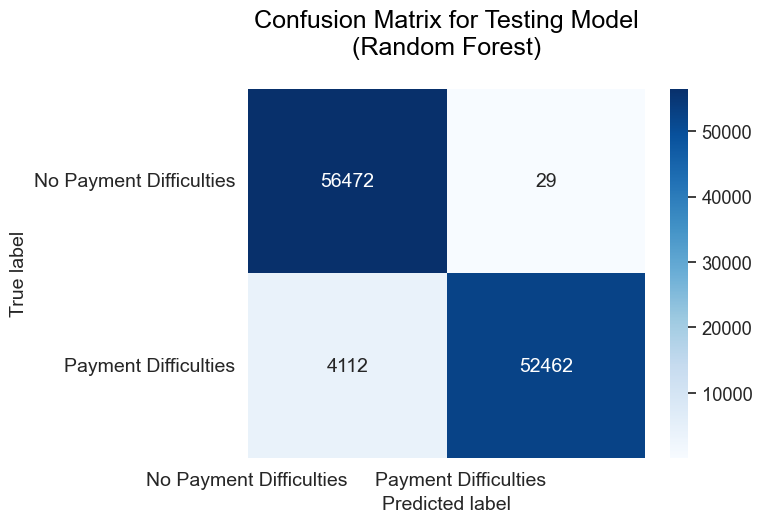

In [108]:
# form confusion matrix as a dataFrame
confusion_matrix_rf = pd.DataFrame((confusion_matrix(y_test, y_test_pred_rf)), ('No Payment Difficulties', 'Payment Difficulties'), ('No Payment Difficulties', 'Payment Difficulties'))

# plot confusion matrix
plt.figure()
heatmap = sns.heatmap(confusion_matrix_rf, annot=True, annot_kws={'size': 14}, fmt='d', cmap='Blues')
heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=14)
heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=0, ha='right', fontsize=14)

plt.title('Confusion Matrix for Testing Model\n(Random Forest)\n', fontsize=18, color='black')
plt.ylabel('True label', fontsize=14)
plt.xlabel('Predicted label', fontsize=14)
plt.show()

👉 <b>Display Overall Accuracy & ROC Score</b>

In [41]:
acc_rf_train=round(rf_model.score(X_train,y_train)*100,2)
acc_rf_test=round(rf_model.score(X_test,y_test)*100,2)
print("Training Accuracy: % {}".format(acc_rf_train))
print("Test Accuracy: % {}".format(acc_rf_test))

Training Accuracy: % 100.0
Test Accuracy: % 96.34


In [42]:
# ROC scores
roc_auc_rf = round(roc_auc_score(y_test, y_test_pred_rf),4)
print('ROC AUC:', roc_auc_rf)

ROC AUC: 0.9634


## <div class="header2" style="font-size: 25px; font-weight: bold;">6.3 | 🤖 Neural Network</div>


👉 <b>Train the Model</b>

In [44]:
# train the model
nn_model = MLPClassifier().fit(X_train, y_train)

👉 <b>Predict Train Data & Show Result</b>

In [45]:
# predit data train
y_train_pred_nn = nn_model.predict(X_train)

# print classification report
print('Classification Report Training Model (Neural Network):')
print(classification_report(y_train, y_train_pred_nn))

Classification Report Training Model (Neural Network):
              precision    recall  f1-score   support

         0.0       0.64      0.63      0.63    226185
         1.0       0.64      0.65      0.64    226112

    accuracy                           0.64    452297
   macro avg       0.64      0.64      0.64    452297
weighted avg       0.64      0.64      0.64    452297



👉 <b>Display Confusion Matrix</b>

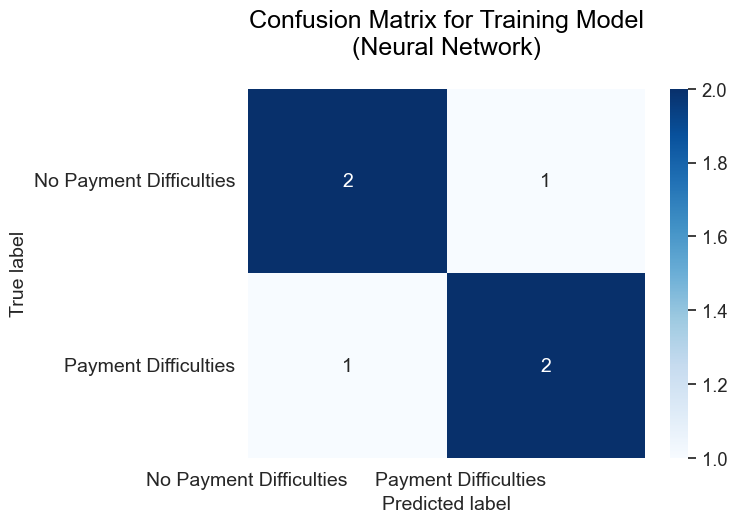

In [93]:
# form confusion matrix as a dataFrame
confusion_matrix_nn = pd.DataFrame((confusion_matrix(y_train, y_train_pred_nn)), ('No Payment Difficulties', 'Payment Difficulties'), ('No Payment Difficulties', 'Payment Difficulties'))

# plot confusion matrix
plt.figure()
heatmap = sns.heatmap(confusion_matrix_nn, annot=True, annot_kws={'size': 14}, fmt='d', cmap='Blues')
heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=14)
heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=0, ha='right', fontsize=14)

plt.title('Confusion Matrix for Training Model\n(Neural Network)\n', fontsize=18, color='black')
plt.ylabel('True label', fontsize=14)
plt.xlabel('Predicted label', fontsize=14)
plt.show()


👉 <b>Predict Test Data & Show Result</b>

In [47]:
# predit data test
y_test_pred_nn = nn_model.predict(X_test)

# print classification report
print('Classification Report Testing Model (Neural Network):')
print(classification_report(y_test, y_test_pred_nn))

Classification Report Testing Model (Neural Network):
              precision    recall  f1-score   support

         0.0       0.64      0.63      0.63     56501
         1.0       0.63      0.64      0.64     56574

    accuracy                           0.63    113075
   macro avg       0.63      0.63      0.63    113075
weighted avg       0.63      0.63      0.63    113075



👉 <b>Display Confusion Matrix</b>

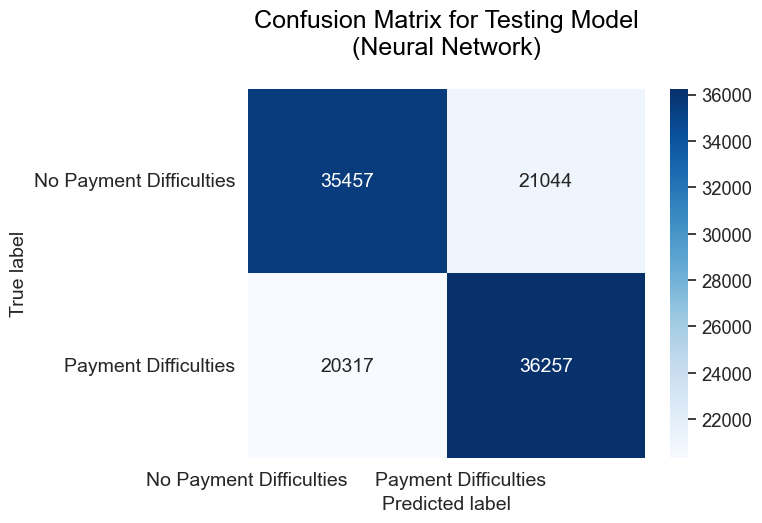

In [109]:
# form confusion matrix as a dataFrame
confusion_matrix_nn = pd.DataFrame((confusion_matrix(y_test, y_test_pred_nn)), ('No Payment Difficulties', 'Payment Difficulties'), ('No Payment Difficulties', 'Payment Difficulties'))

# plot confusion matrix
plt.figure()
heatmap = sns.heatmap(confusion_matrix_nn, annot=True, annot_kws={'size': 14}, fmt='d', cmap='Blues')
heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=14)
heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=0, ha='right', fontsize=14)

plt.title('Confusion Matrix for Testing Model\n(Neural Network)\n', fontsize=18, color='black')
plt.ylabel('True label', fontsize=14)
plt.xlabel('Predicted label', fontsize=14)
plt.show()

👉 <b>Display Overall Accuracy & ROC Score</b>

In [49]:
acc_nn_train=round(nn_model.score(X_train,y_train)*100,2)
acc_nn_test=round(nn_model.score(X_test,y_test)*100,2)
print("Training Accuracy: % {}".format(acc_nn_train))
print("Test Accuracy: % {}".format(acc_nn_test))

Training Accuracy: % 63.91
Test Accuracy: % 63.42


In [50]:
# ROC scores
roc_auc_nn = round(roc_auc_score(y_test, y_test_pred_nn),4)
print('ROC AUC:', roc_auc_nn)

ROC AUC: 0.6342


# <div class="header1" style="font-size: 38px; font-weight: bold;color: #FF5733">7. | 🏁 Conclusion & Insight</div>
<br>

## <div class="header2" style="font-size: 25px; font-weight: bold;">7.1 | 🤖 Model Selection</div>


👉 <b>Display Comparation Table</b>

In [67]:
data = [["Logistic Regression", 0.5993, 0.6007, 0.6007],
        ["Random Forest", 1, 0.9697, 0.9697],
        ["Neural Network", 0.6381, 0.6306, 0.6307]]

columns = ["Models", "Training Accuracy Score", "Testing Accuracy Score", "ROC Score"]

results = pd.DataFrame(data, columns=columns)

results = (results.sort_values(by=['Training Accuracy Score', 'Testing Accuracy Score'], ascending=False)
                  .reset_index(drop=True)
                  .set_index(pd.Index(range(1, len(results) + 1)))
                  .style.background_gradient(cmap='Blues', subset=columns[1:])
                  .set_properties(**{'text-align': 'center'})
                  .set_table_styles([{'selector': 'th', 'props': [('background-color', 'lightgrey'), ('text-align', 'center')]}]))

results


,Models,Training Accuracy Score,Testing Accuracy Score,ROC Score
1,Random Forest,1.000000,0.969700,0.969700
2,Neural Network,0.638100,0.630600,0.630700
3,Logistic Regression,0.599300,0.600700,0.600700


## <div class="header2" style="font-size: 25px; font-weight: bold;">7.2 | 🤖 Business Recommendation</div>


👉 <b>Complete Automation</b><br>
Submissions are instantly accepted or rejected based on the model.<br><br>
👉 <b>Auto-Reject</b><br>
Likely problematic submissions are automatically rejected, with uncertain ones reviewed by the team.<br><br>
👉 <b>Partial Auto-Reject & Auto-Approve</b><br>
High-quality submissions are auto-approved, problematic ones are instantly rejected, and the rest undergo manual assessment by the team.